# Project 3 - Artificial Neural Networks

# Dataset 1: Flower Species Dataset

In [1]:
class_names = ['Roses', 'Magnolias', 'Lilies', 'Sunflowers', 'Orchids',
               'Marigold', 'Hibiscus', 'Firebush', 'Pentas', 'Bougainvillea']

Let's visualize the dataset:

In [2]:
import numpy as np
import numpy.random as npr
import matplotlib.pyplot as plt
%matplotlib inline
plt.style.use('bmh')

# Loading Training Data
# X_train = np.load('flower_species_classification/data_train.npy').T
# t_train = np.load('flower_species_classification/labels_train.npy')

X_train = np.load("C:/Users/barla/Music/flower_species_classification/data_train.npy").T
t_train = np.load("C:/Users/barla/Music/flower_species_classification/labels_train.npy")


print(X_train.shape, t_train.shape)

(1658, 270000) (1658,)


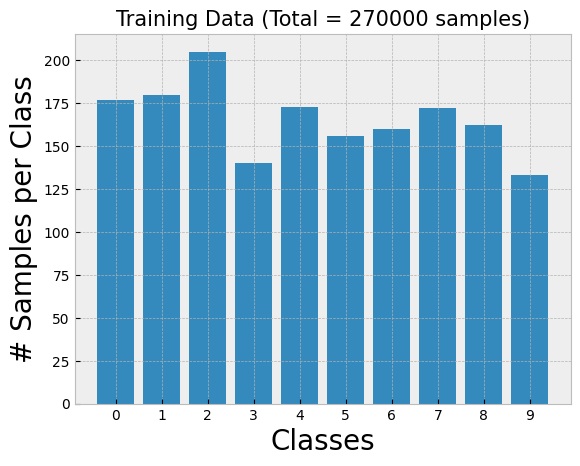

In [3]:
# Counting number samples per class
vals, counts = np.unique(t_train, return_counts=True)

plt.bar(vals, counts)
plt.xticks(range(10),range(10))
plt.xlabel('Classes',size=20)
plt.ylabel('# Samples per Class', size=20)
plt.title('Training Data (Total = '+str(X_train.shape[1])+' samples)',size=15);

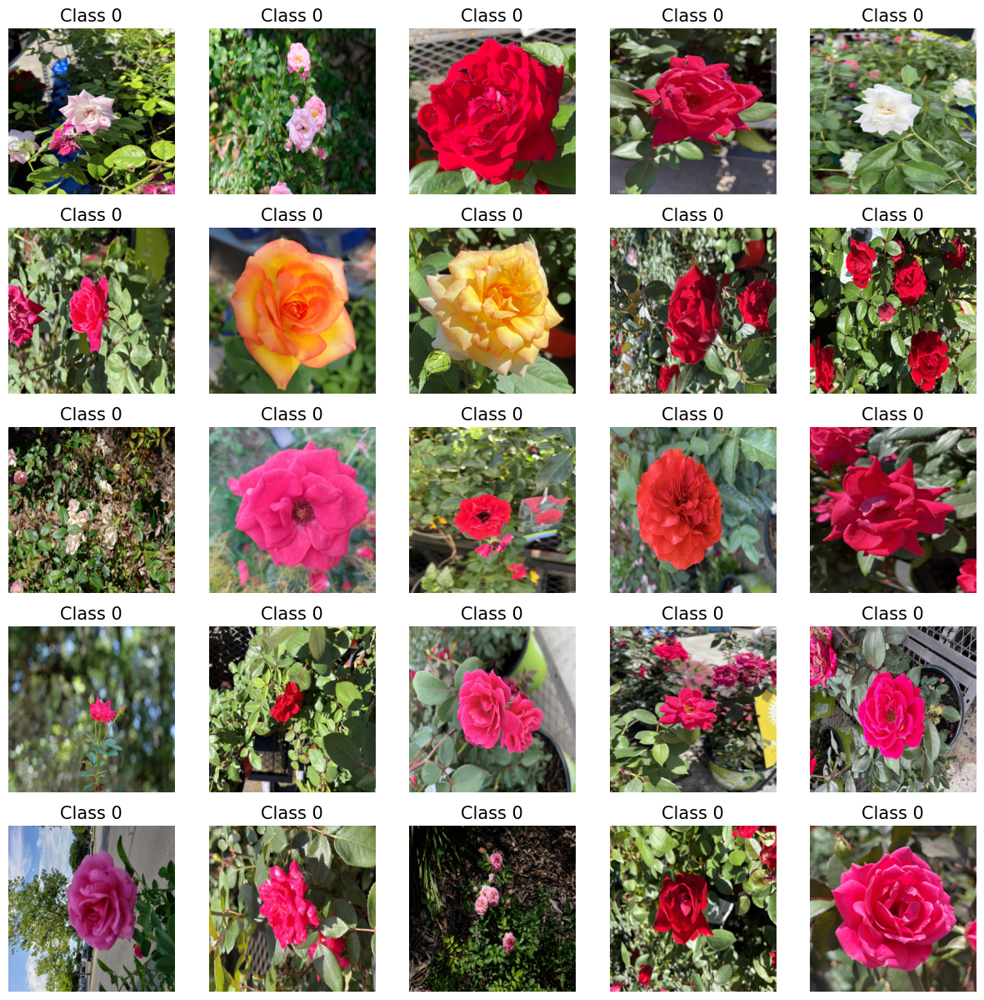

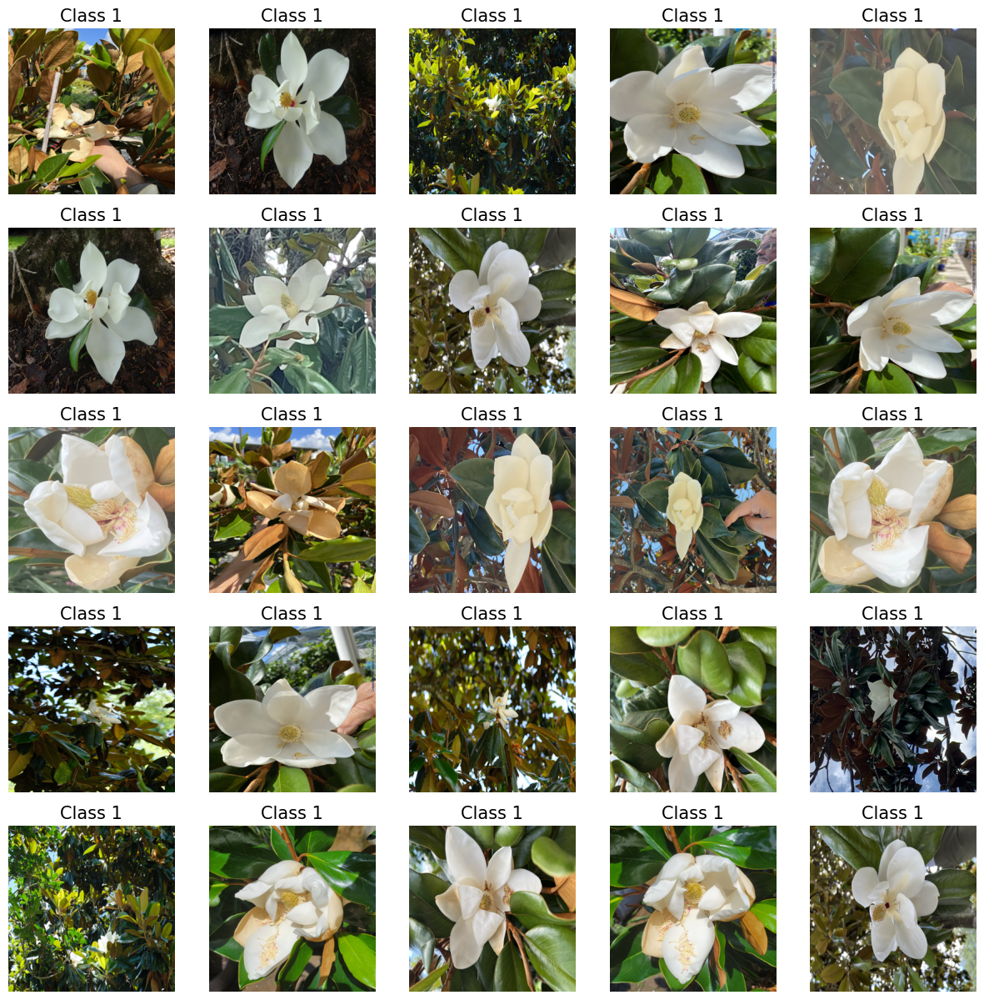

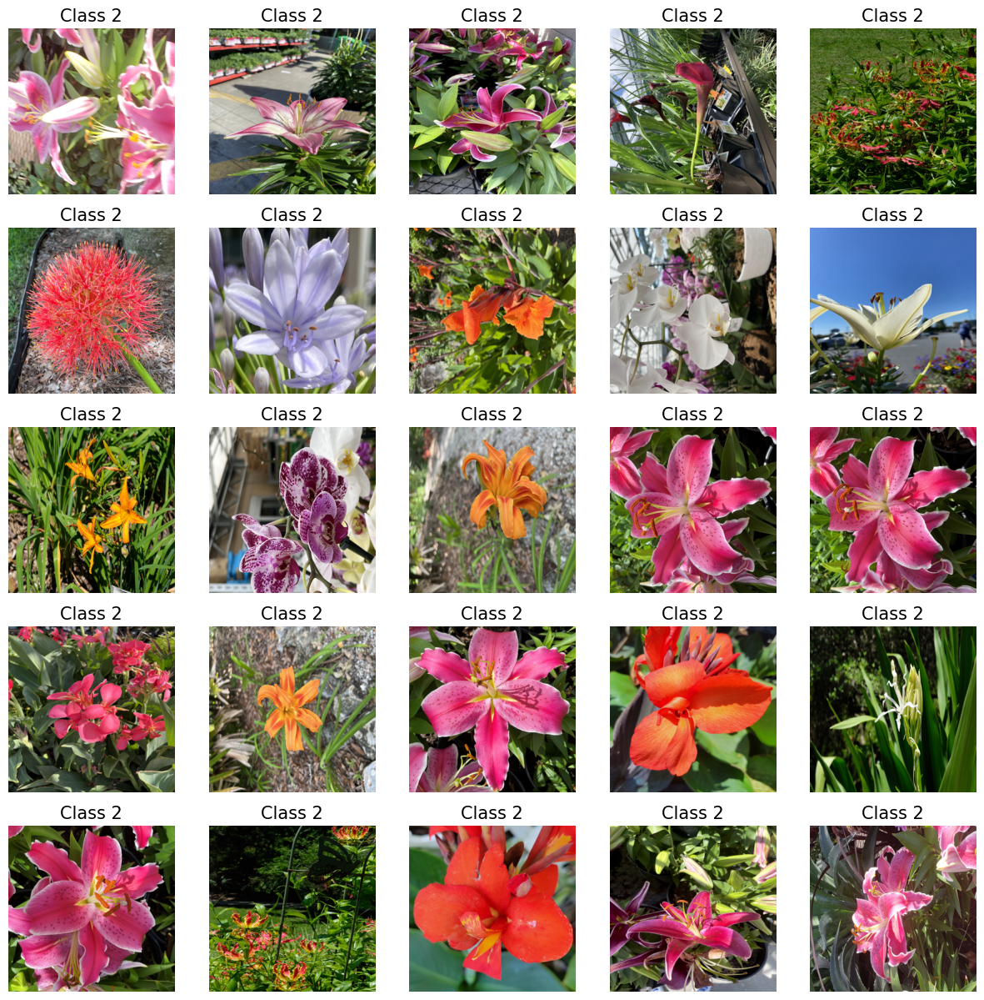

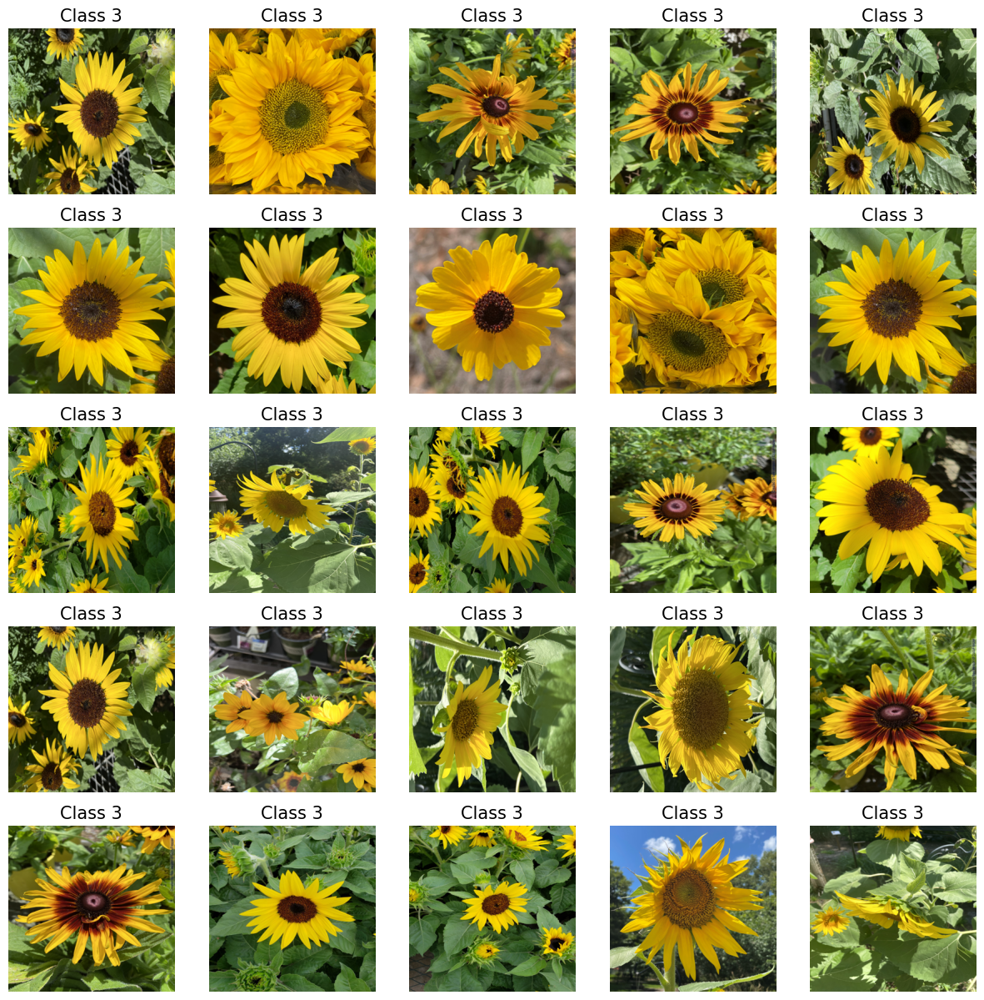

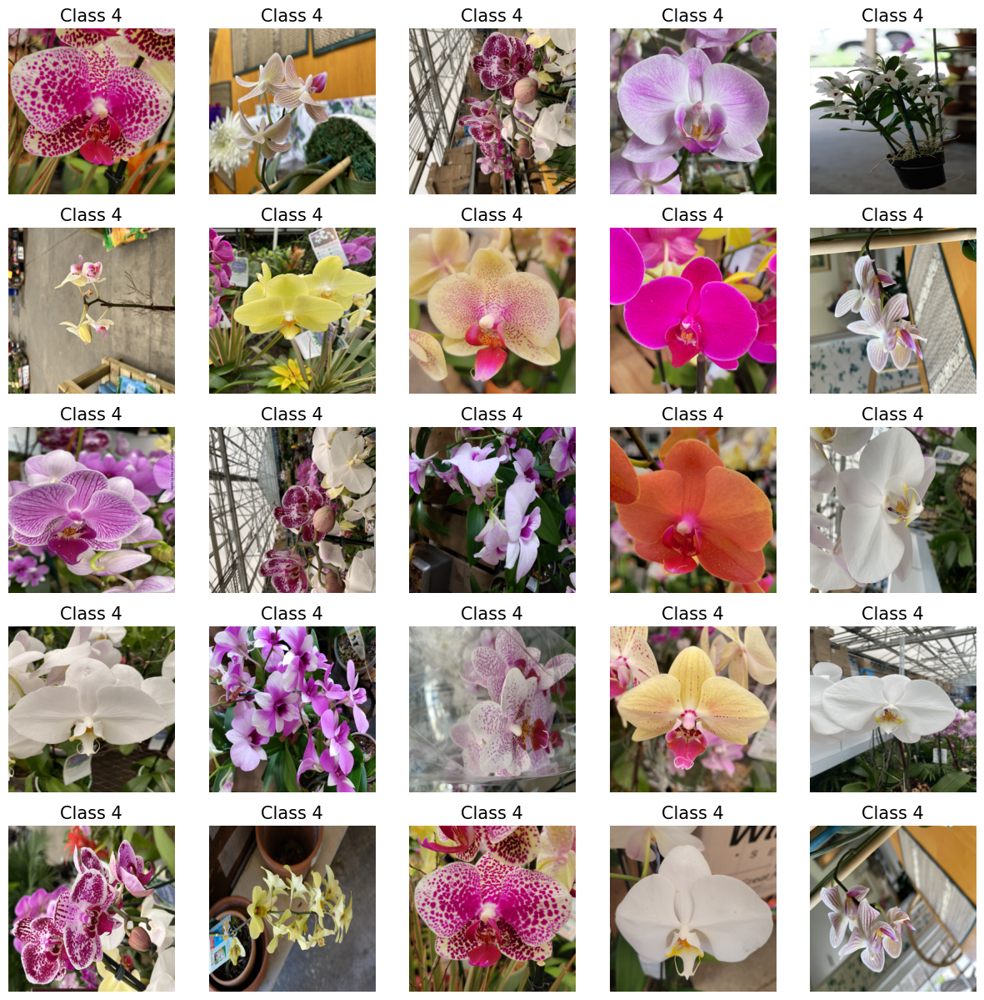

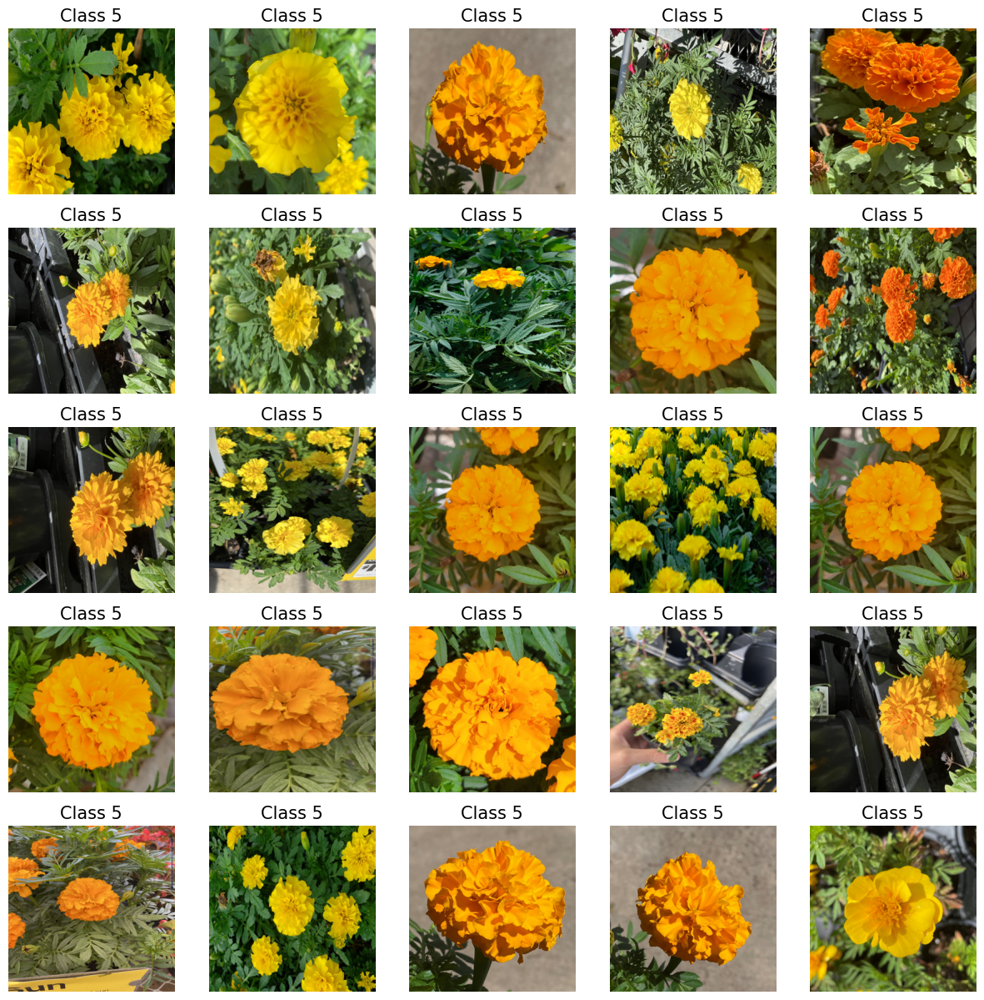

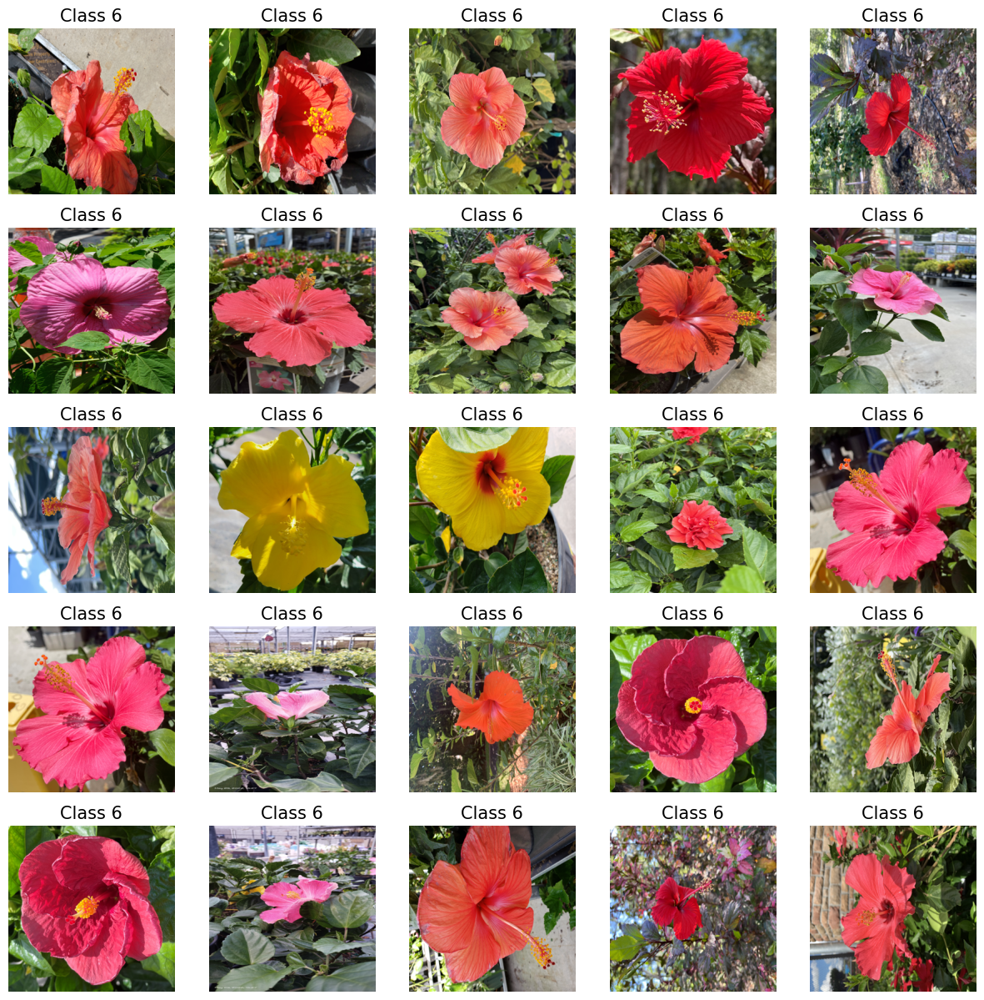

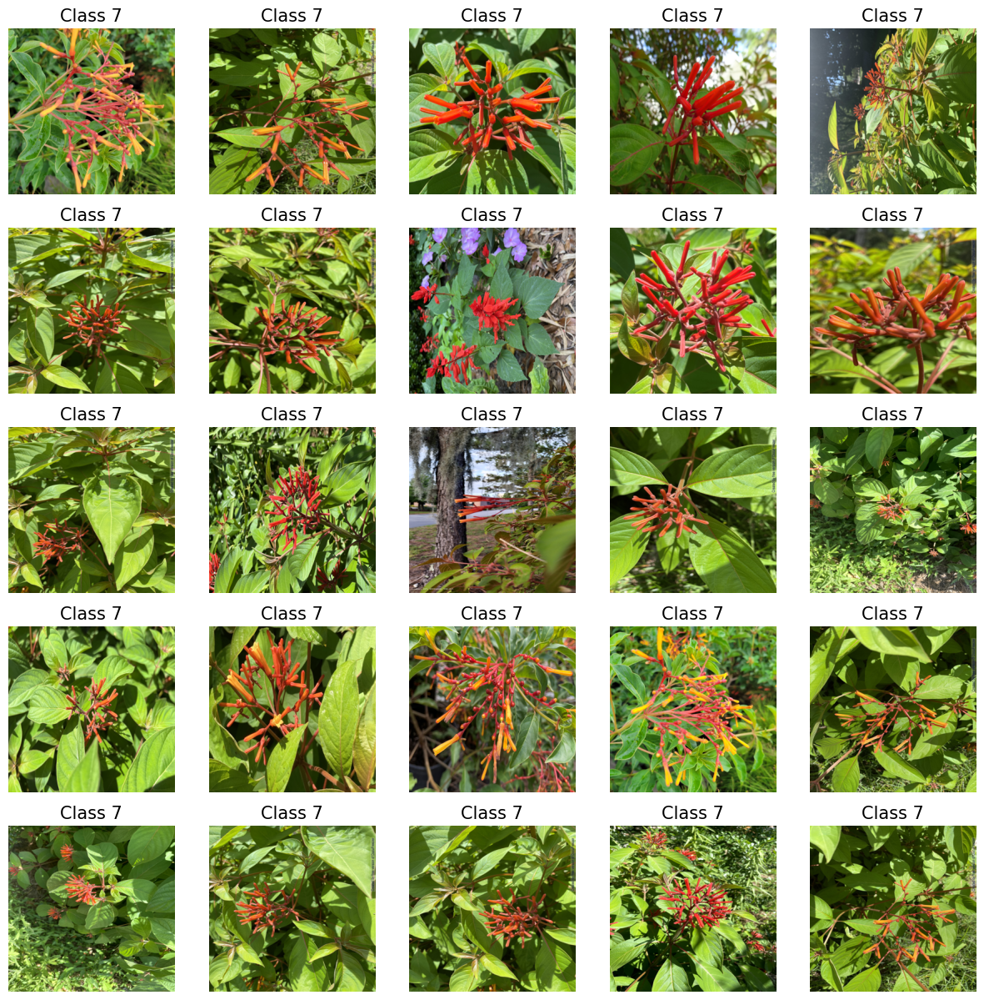

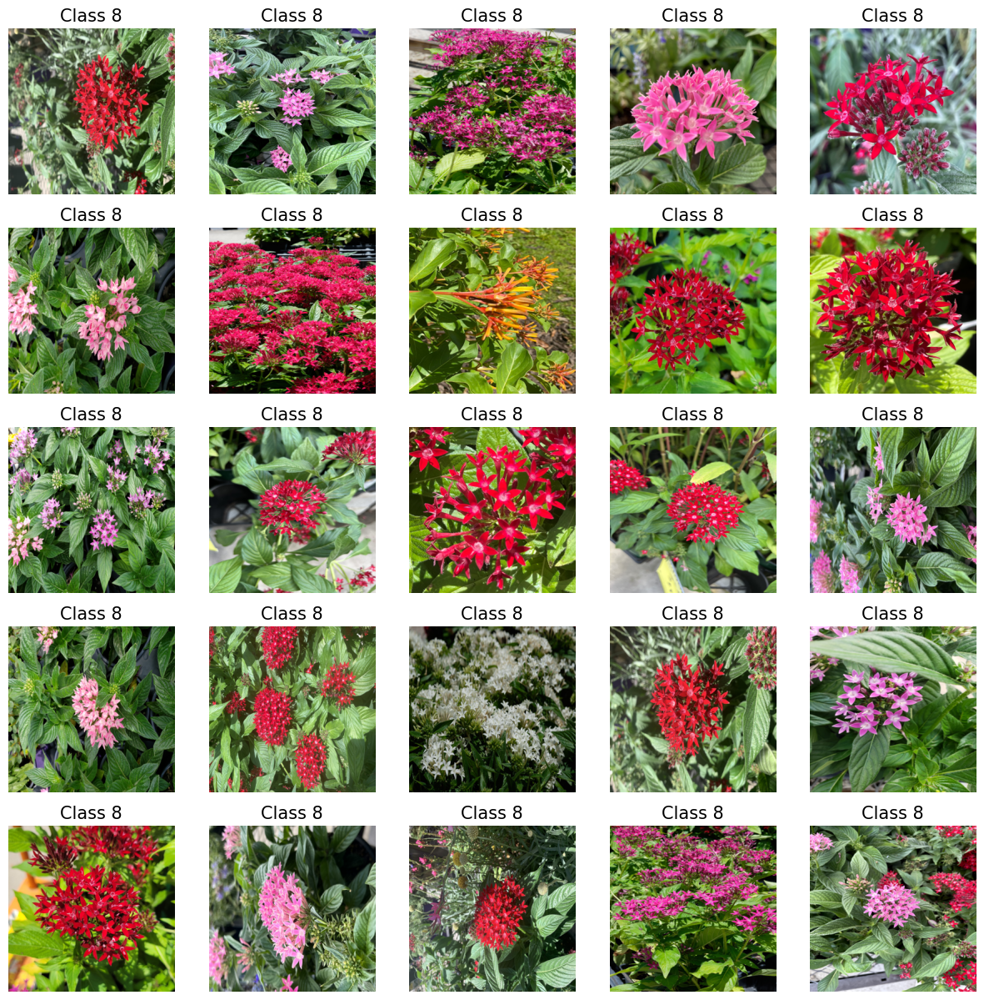

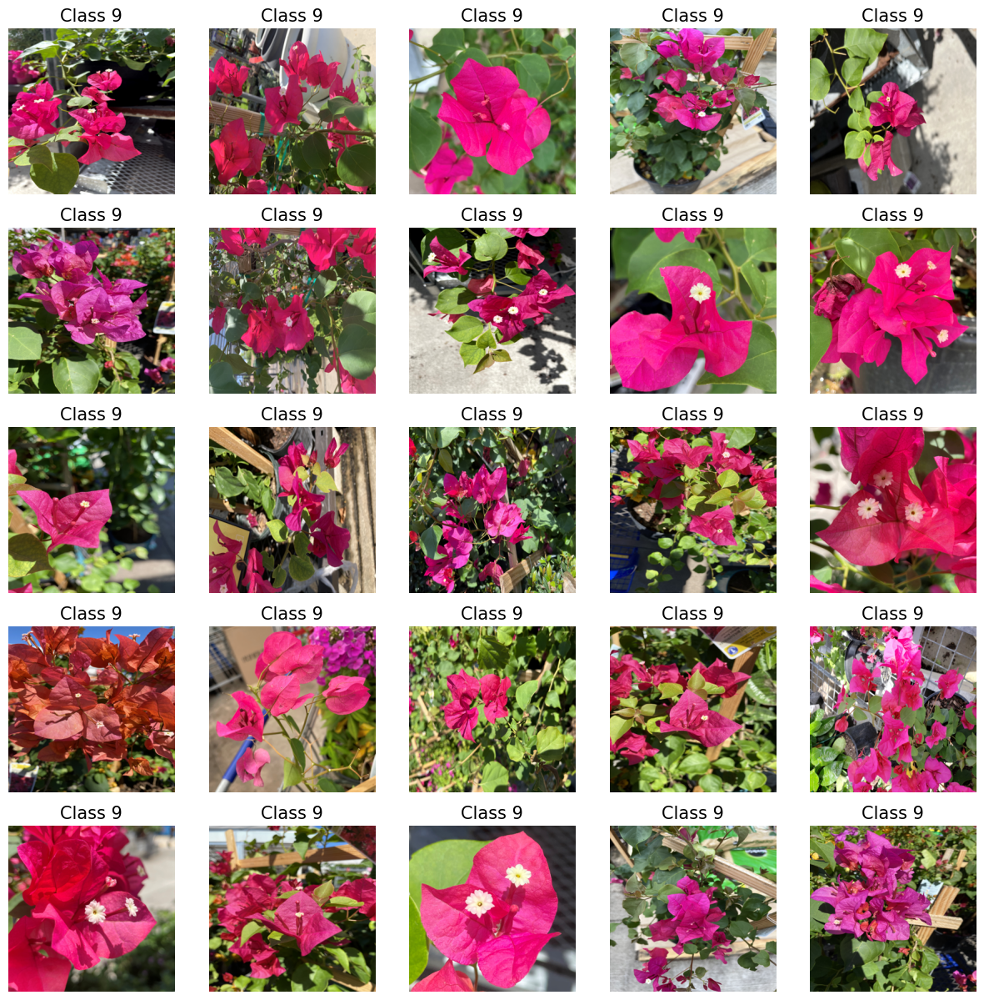

In [3]:
# Displaying some random examples per class

for i in range(0,10):
    rnd_sample = npr.permutation(np.where(t_train==i)[0])
    fig=plt.figure(figsize=(15,15))
    for j in range(25):
        fig.add_subplot(5,5,j+1)
        plt.imshow(X_train[rnd_sample[j],:].reshape((300,300,3)))
        plt.axis('off');plt.title('Class '+str(int(t_train[rnd_sample[j]])),size=15)
    plt.show()
    print('\n\n')

### Training a Neural Network from scratch

In [3]:
import tensorflow as tf
import keras
import cv2
from sklearn.model_selection import train_test_split

In [6]:
# Reshaping and normalizing the data
X_train_scaled = X_train.reshape(-1, 300, 300, 3) / 255.0

# Reducing the pixel size of the images to facilitate limited computational resources
D = 300
X_train = np.array([cv2.resize(x.reshape(300,300,3),(D,D)) for x in X_train_scaled])

# Splitting the dataset
X_train, X_val, t_train, t_val = train_test_split(X_train, t_train,
                                                  test_size=0.2, random_state=43)

In [7]:
# Defining the model architecture
flower_model = tf.keras.models.Sequential([
    tf.keras.layers.Conv2D(32, 3, activation='relu', input_shape=(D, D, 3)),
    tf.keras.layers.MaxPooling2D(2, 2),
    tf.keras.layers.Conv2D(64, 3, activation='relu'),
    tf.keras.layers.MaxPooling2D(2, 2),
    tf.keras.layers.Conv2D(128, 3, activation='relu', strides=2),
    tf.keras.layers.MaxPooling2D(2, 2),
    tf.keras.layers.Conv2D(256, 3, activation='relu'),
    tf.keras.layers.MaxPooling2D(2, 2),
    tf.keras.layers.Conv2D(512, (3, 3), activation='relu'),
    tf.keras.layers.MaxPooling2D(2, 2),
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(128, activation='relu'),
    tf.keras.layers.Dropout(0.5),
    tf.keras.layers.Dense(64, activation='relu'),
    tf.keras.layers.Dropout(0.5),
    tf.keras.layers.Dense(10, activation='softmax')
])

flower_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 298, 298, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2  (None, 149, 149, 32)      0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 147, 147, 64)      18496     
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 73, 73, 64)        0         
 g2D)                                                            
                                                                 
 conv2d_2 (Conv2D)           (None, 36, 36, 128)       73856     
                                                                 
 max_pooling2d_2 (MaxPoolin  (None, 18, 18, 128)       0

In [8]:
# Compiling the model
# keras.optimizers.Nadam()
# keras.optimizers.Adam(lr=0.001, beta_1=0.9, beta_2=0.999, epsilon=1e-08, decay=0.0)
flower_model.compile(optimizer=keras.optimizers.Nadam(),
                     loss=keras.losses.SparseCategoricalCrossentropy(),
                     metrics=['accuracy'])

In [9]:
# Defining the Callbacks
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=10)
checkpoint_cb = tf.keras.callbacks.ModelCheckpoint("flower_model.h5", save_best_only=True)

# Training the model
history = flower_model.fit(X_train, t_train,
                           epochs=50,
                           batch_size=64,
                           validation_data=(X_val, t_val),
                           callbacks=[early_stopping, checkpoint_cb])

Epoch 1/50
21/21 [==============================] - 58s 3s/step - loss: 2.2911 - accuracy: 0.1214 - val_loss: 2.2229 - val_accuracy: 0.1747
Epoch 2/50


C:\ProgramData\anaconda3\envs\jupyterlab\Lib\site-packages\keras\src\engine\training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


21/21 [==============================] - 54s 3s/step - loss: 2.1828 - accuracy: 0.1606 - val_loss: 2.0624 - val_accuracy: 0.2289
Epoch 3/50
21/21 [==============================] - 53s 3s/step - loss: 2.0638 - accuracy: 0.2029 - val_loss: 1.8959 - val_accuracy: 0.2982
Epoch 4/50
21/21 [==============================] - 52s 2s/step - loss: 1.9848 - accuracy: 0.2443 - val_loss: 1.7507 - val_accuracy: 0.3343
Epoch 5/50
21/21 [==============================] - 52s 2s/step - loss: 1.9220 - accuracy: 0.2617 - val_loss: 1.7165 - val_accuracy: 0.3494
Epoch 6/50
21/21 [==============================] - 52s 2s/step - loss: 1.7957 - accuracy: 0.3175 - val_loss: 1.5555 - val_accuracy: 0.4639
Epoch 7/50
21/21 [==============================] - 51s 2s/step - loss: 1.6513 - accuracy: 0.3658 - val_loss: 1.4372 - val_accuracy: 0.5030
Epoch 8/50
21/21 [==============================] - 51s 2s/step - loss: 1.5856 - accuracy: 0.3937 - val_loss: 1.3625 - val_accuracy: 0.5060
Epoch 9/50
21/21 [=============

11/11 [==============================] - 2s 192ms/step - loss: 0.4738 - accuracy: 0.8795
Train accuracy: 0.9969834089279175, Validation accuracy: 0.8795180916786194


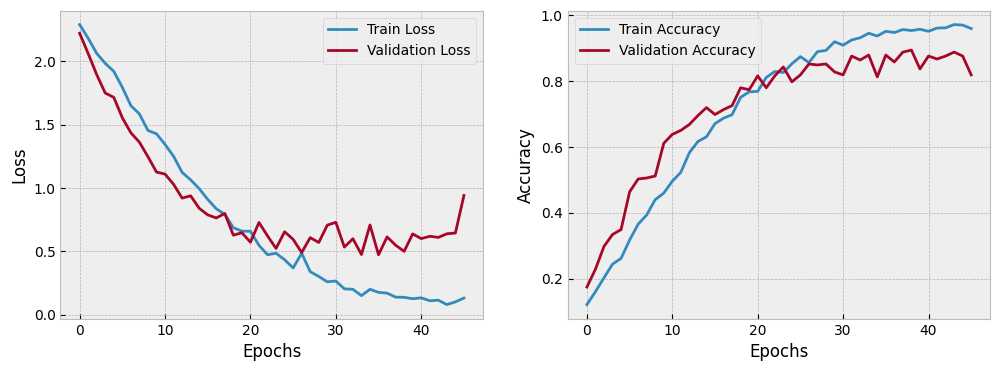

In [10]:
# Evaluating the model
model = tf.keras.models.load_model("flower_model.h5") # Loading the best model
train_loss, train_accuracy = model.evaluate(X_train, t_train)
val_loss, val_accuracy = model.evaluate(X_val, t_val)
print(f"Train accuracy: {train_accuracy}, Validation accuracy: {val_accuracy}")

# Plotting the learning curves
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

Now training on the entire training dataset,

In [19]:
flower_model_preds_train = model.predict(X_train)
flower_model_preds_val = model.predict(X_val)

11/11 [==============================] - 2s 194ms/step


In [21]:
from sklearn.metrics import classification_report
print('Classification report on the Training set:')
print(classification_report(t_train,np.argmax(flower_model_preds_train, axis=1), target_names=class_names))
print('Classification report on the Validation set:')
print(classification_report(t_val,np.argmax(flower_model_preds_val, axis=1), target_names=class_names))

Classification report on the Training set:
               precision    recall  f1-score   support

        Roses       1.00      1.00      1.00       138
    Magnolias       1.00      1.00      1.00       147
       Lilies       0.99      0.99      0.99       168
   Sunflowers       1.00      1.00      1.00       108
      Orchids       0.99      0.99      0.99       137
     Marigold       0.99      1.00      1.00       123
     Hibiscus       1.00      0.99      1.00       131
     Firebush       1.00      1.00      1.00       132
       Pentas       1.00      1.00      1.00       140
Bougainvillea       1.00      1.00      1.00       102

     accuracy                           1.00      1326
    macro avg       1.00      1.00      1.00      1326
 weighted avg       1.00      1.00      1.00      1326

Classification report on the Validation set:
               precision    recall  f1-score   support

        Roses       0.83      0.87      0.85        39
    Magnolias       0.91    

Confusion Matrix for the Training set:


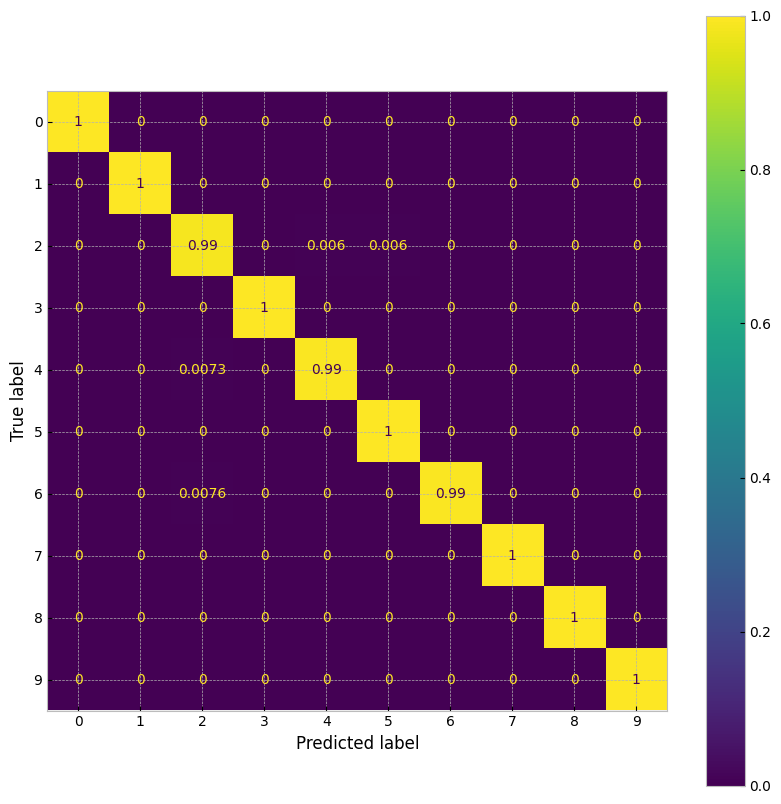

Confusion Matrix for the validation set:


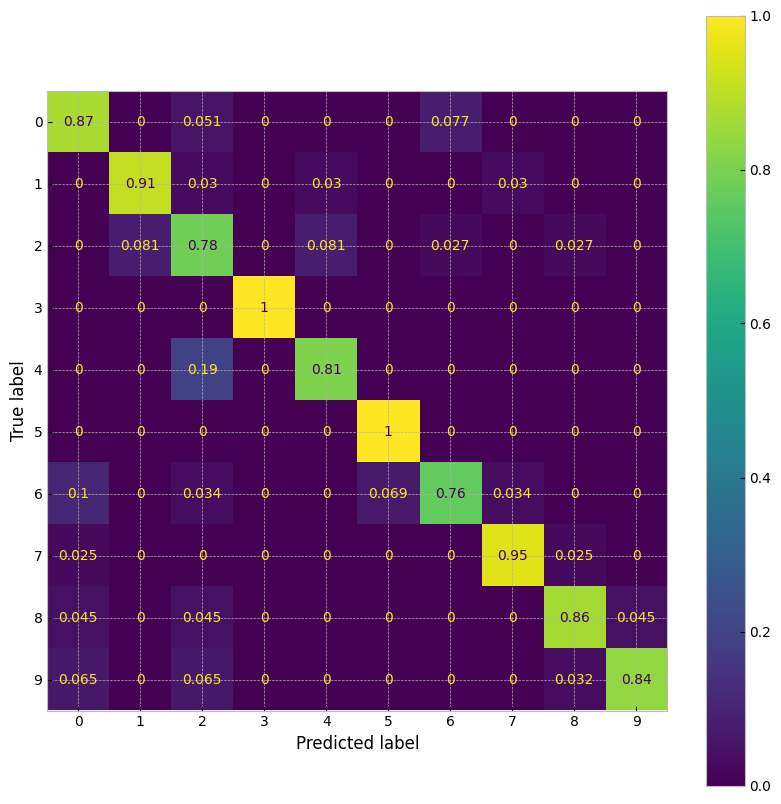

In [29]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

print('Confusion Matrix for the Training set:')
cm = confusion_matrix(t_train, np.argmax(flower_model_preds_train, axis=1), normalize='true')
disp = ConfusionMatrixDisplay(cm)
fig, ax = plt.subplots(figsize=(10,10))
disp.plot(ax=ax)
plt.show()

print('Confusion Matrix for the validation set:')
cm = confusion_matrix(t_val, np.argmax(flower_model_preds_val, axis=1), normalize='true')
disp = ConfusionMatrixDisplay(cm)
fig, ax = plt.subplots(figsize=(10,10))
disp.plot(ax=ax)
plt.show()

## Training using Transfer learning with ResNet50

In [4]:
# Loading Training Data
# X_train = np.load('flower_species_classification/data_train.npy').T
# t_train = np.load('flower_species_classification/labels_train.npy')

X_train = np.load("C:/Users/barla/Music/flower_species_classification/data_train.npy").T
t_train = np.load("C:/Users/barla/Music/flower_species_classification/labels_train.npy")

# Reshaping and normalizing the data
X_train_scaled = X_train.reshape(-1, 300, 300, 3) / 255.0

# Reducing the pixel size of the images to facilitate limited computational resources
D = 150
X_train = np.array([cv2.resize(x.reshape(300,300,3),(D,D)) for x in X_train_scaled])

# Splitting the dataset
X_train, X_val, t_train, t_val = train_test_split(X_train, t_train, stratify=t_train,
                                                  test_size=0.2, random_state=42)

In [5]:
# Importing trained ResNet50 model
base_model = keras.applications.ResNet50V2(
    input_shape=(D, D, 3),
    weights='imagenet',
    include_top=False)

for layer in base_model.layers[:-5]:
    layer.trainable = False

# Adding more layers
flower_resnet = tf.keras.models.Sequential([
    base_model,
    keras.layers.GlobalAveragePooling2D(),
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(256, activation='relu'),
    tf.keras.layers.Dropout(0.5),
    tf.keras.layers.Dense(64, activation='relu'),
    tf.keras.layers.Dropout(0.5),
    tf.keras.layers.Dense(10, activation='softmax')
])

flower_resnet.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet50v2 (Functional)     (None, 5, 5, 2048)        23564800  
                                                                 
 global_average_pooling2d (  (None, 2048)              0         
 GlobalAveragePooling2D)                                         
                                                                 
 flatten (Flatten)           (None, 2048)              0         
                                                                 
 dense (Dense)               (None, 256)               524544    
                                                                 
 dropout (Dropout)           (None, 256)               0         
                                                                 
 dense_1 (Dense)             (None, 64)                16448     
                                                        

In [6]:
# Compiling the model
flower_resnet.compile(optimizer=keras.optimizers.Nadam(),
                      loss=keras.losses.SparseCategoricalCrossentropy(),
                      metrics=['accuracy'])

# Defining the Callbacks
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=10)
checkpoint_cb = tf.keras.callbacks.ModelCheckpoint("flower_resnet.h5", save_best_only=True)

# Training the model
history = flower_resnet.fit(X_train, t_train,
                            validation_data=(X_val,t_val),
                            batch_size=64,
                            epochs=75,
                            callbacks=[early_stopping,checkpoint_cb])

Epoch 1/75
21/21 [==============================] - ETA: 0s - loss: 1.9765 - accuracy: 0.3560

C:\ProgramData\anaconda3\envs\jupyterlab\Lib\site-packages\keras\src\engine\training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


21/21 [==============================] - 34s 1s/step - loss: 1.9765 - accuracy: 0.3560 - val_loss: 1.1474 - val_accuracy: 0.6596
Epoch 2/75
21/21 [==============================] - 29s 1s/step - loss: 1.0986 - accuracy: 0.6456 - val_loss: 0.9730 - val_accuracy: 0.7319
Epoch 3/75
21/21 [==============================] - 27s 1s/step - loss: 0.7608 - accuracy: 0.7632 - val_loss: 0.8096 - val_accuracy: 0.8012
Epoch 4/75
21/21 [==============================] - 26s 1s/step - loss: 0.5674 - accuracy: 0.8205 - val_loss: 0.7909 - val_accuracy: 0.8133
Epoch 5/75
21/21 [==============================] - 26s 1s/step - loss: 0.3793 - accuracy: 0.8906 - val_loss: 0.6034 - val_accuracy: 0.8464
Epoch 6/75
21/21 [==============================] - 26s 1s/step - loss: 0.3023 - accuracy: 0.9042 - val_loss: 0.6562 - val_accuracy: 0.8434
Epoch 7/75
21/21 [==============================] - 26s 1s/step - loss: 0.2532 - accuracy: 0.9261 - val_loss: 0.6657 - val_accuracy: 0.8614
Epoch 8/75
21/21 [=============

11/11 [==============================] - 6s 532ms/step - loss: 0.6028 - accuracy: 0.8886
Train accuracy: 0.9954751133918762, Validation accuracy: 0.8885542154312134


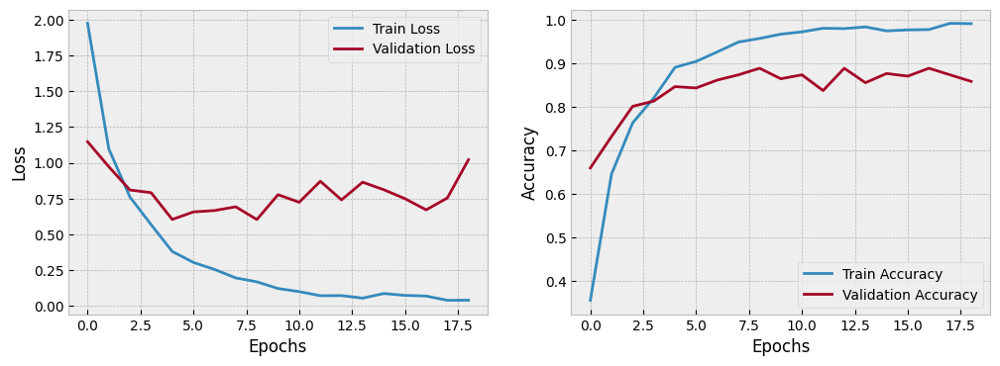

11/11 [==============================] - 6s 543ms/step
Classification report on the Training set:
               precision    recall  f1-score   support

        Roses       1.00      0.99      0.99       141
    Magnolias       1.00      1.00      1.00       144
       Lilies       0.99      1.00      1.00       164
   Sunflowers       1.00      0.99      1.00       112
      Orchids       1.00      1.00      1.00       138
     Marigold       0.98      1.00      0.99       125
     Hibiscus       0.98      0.99      0.99       128
     Firebush       1.00      1.00      1.00       138
       Pentas       1.00      0.98      0.99       130
Bougainvillea       0.99      1.00      1.00       106

     accuracy                           1.00      1326
    macro avg       1.00      1.00      1.00      1326
 weighted avg       1.00      1.00      1.00      1326

Classification report on the Validation set:
               precision    recall  f1-score   support

        Roses       0.87    

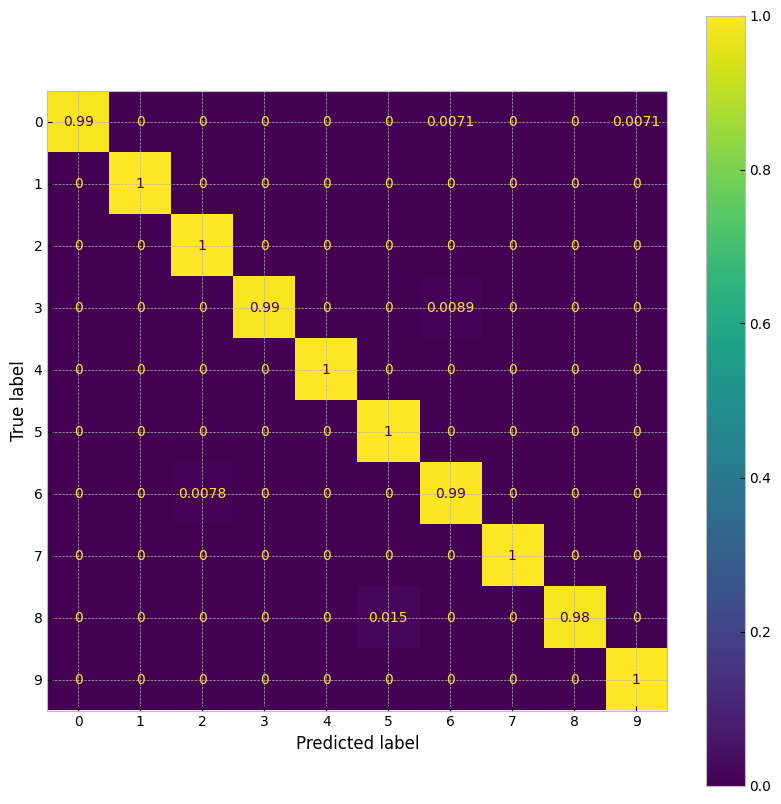

Confusion Matrix for the validation set:


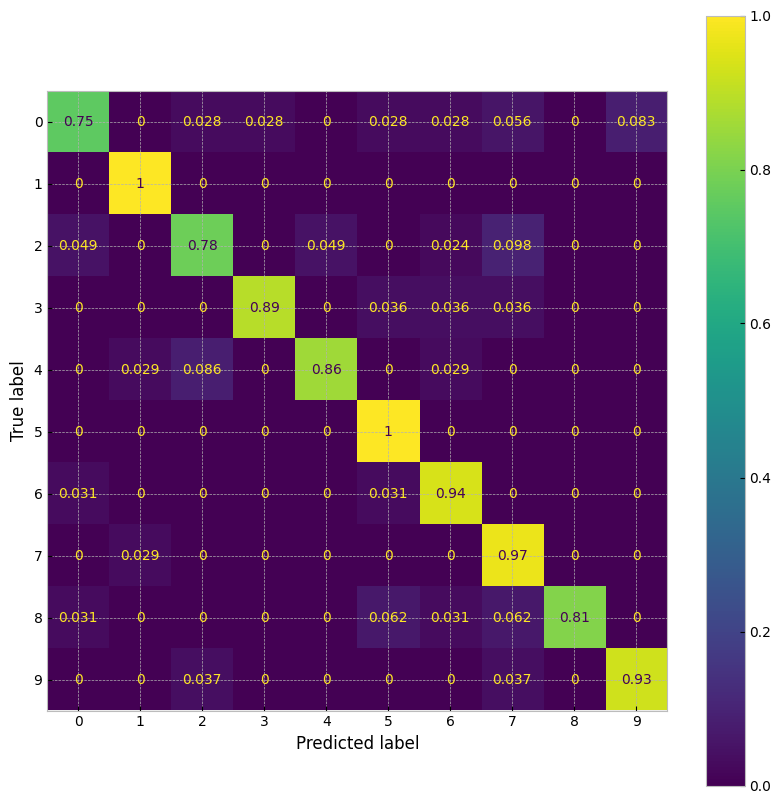

In [7]:
# Evaluating the model
model = tf.keras.models.load_model("flower_resnet.h5") # Loading the best model
train_loss, train_accuracy = model.evaluate(X_train, t_train)
val_loss, val_accuracy = model.evaluate(X_val, t_val)
print(f"Train accuracy: {train_accuracy}, Validation accuracy: {val_accuracy}")

# Plotting the learning curves
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

flower_resnet_preds_train = model.predict(X_train)
flower_resnet_preds_val = model.predict(X_val)

from sklearn.metrics import classification_report
print('Classification report on the Training set:')
print(classification_report(t_train,np.argmax(flower_resnet_preds_train, axis=1), target_names=class_names))
print('Classification report on the Validation set:')
print(classification_report(t_val,np.argmax(flower_resnet_preds_val, axis=1), target_names=class_names))

from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

print('Confusion Matrix for the Training set:')
cm = confusion_matrix(t_train, np.argmax(flower_resnet_preds_train, axis=1), normalize='true')
disp = ConfusionMatrixDisplay(cm)
fig, ax = plt.subplots(figsize=(10,10))
disp.plot(ax=ax)
plt.show()

print('Confusion Matrix for the validation set:')
cm = confusion_matrix(t_val, np.argmax(flower_resnet_preds_val, axis=1), normalize='true')
disp = ConfusionMatrixDisplay(cm)
fig, ax = plt.subplots(figsize=(10,10))
disp.plot(ax=ax)
plt.show()

---

# Dataset 2: Car Detection Dataset

This dataset contains labeled annotations for 559 training samples. Each annotation corresponds to a bounding box of the object **car**.

The goal is to train an object (car) detection artificial neural network using the training samples, and make predictions for the images in test.

Let's visualize the data:

In [1]:
from PIL import Image
import cv2 # install opencv, if you don't already have it (https://pypi.org/project/opencv-python/)
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [2]:
bbox = pd.read_csv(r'C:\Users\barla\Music\car_detection_dataset\train_bounding_boxes.csv')
bbox

,image,xmin,ymin,xmax,ymax
0,vid_4_1000.jpg,281.259045,187.035071,327.727931,223.225547
1,vid_4_10000.jpg,15.163531,187.035071,120.329957,236.430180
2,vid_4_10040.jpg,239.192475,176.764801,361.968162,236.430180
3,vid_4_10020.jpg,496.483358,172.363256,630.020260,231.539575
4,vid_4_10060.jpg,16.630970,186.546010,132.558611,238.386422
...,...,...,...,...,...
554,vid_4_9860.jpg,0.000000,198.321729,49.235251,236.223284
555,vid_4_9880.jpg,329.876184,156.482351,536.664239,250.497895
556,vid_4_9900.jpg,0.000000,168.295823,141.797524,239.176652
557,vid_4_9960.jpg,487.428988,172.233646,616.917699,228.839864


In [3]:
N = len(bbox) # no. of training samples

# Create a numpy array with all images
for i in range(N):
    filename='car_detection_dataset/training_images/'+bbox['image'][i]
    image = np.array(Image.open(filename))
    image_col = image.ravel()[:,np.newaxis]

    if i==0:
        X_train = image_col
    else:
        X_train = np.hstack((X_train, image_col))

# Training feature matrices
X_train = X_train.T

# Training labels
t_train = bbox.drop('image', axis=1).round().to_numpy().astype(int)

X_train.shape, t_train.shape

((559, 770640), (559, 4))

Note that this code cell only collects data for images that contain a car within it. You may consider modifying to include all images. If no annotations is included, then assume there is no object and assign the target label [0,0,0,0].

In [4]:
# size of each RGB image
(Nx,Ny,Nz) = image.shape

Nx, Ny, Nz

(380, 676, 3)

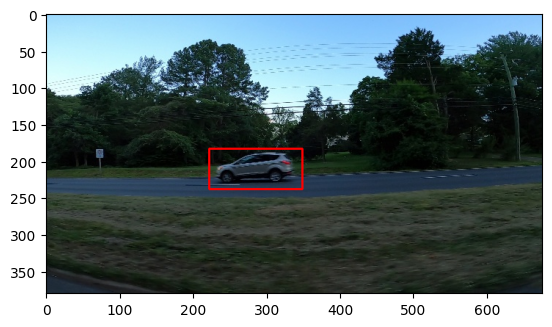

In [6]:
# Example of object visualization using opencv rectangle function
idx=N-1
x= image

plt.imshow(x)
cv2.rectangle(x, (t_train[idx,0], t_train[idx,1]),
              (t_train[idx,2], t_train[idx,3]),
              (255, 0, 0), 2);

---

## Using YOLO v8 for Object Detection

### Data Augmentation

In [ ]:
import pandas as pd
import os

# Converting the bounding box labels into YOLO format
def convert_to_yolo_format(row, image_width, image_height):
    x_center = ((row['xmax'] + row['xmin']) / 2) / image_width
    y_center = ((row['ymax'] + row['ymin']) / 2) / image_height
    width = (row['xmax'] - row['xmin']) / image_width
    height = (row['ymax'] - row['ymin']) / image_height
    return f'0 {x_center} {y_center} {width} {height}'

def main():
    csv_file = 'train_bounding_boxes.csv'
    df = pd.read_csv(csv_file)

    # Image dimensions
    image_width = 676
    image_height = 380

    output_folder = 'training_labels'
    os.makedirs(output_folder, exist_ok=True)
    
    for i, row in df.iterrows():
        yolo_label = convert_to_yolo_format(row, image_width, image_height)
        base_filename = os.path.splitext(row['image'])[0]
        output_file = os.path.join(output_folder, base_filename + '.txt')

        with open(output_file, 'a') as file:
            file.write(yolo_label + '\n')

main()

### Splitting the Data into Training and Validation

In [ ]:
import os
import shutil

images = os.listdir('train/images/')

moving_list = []

for i in range(150):
    moving_list.append(images[i])
    
img_source = 'train/images/'
img_dest = 'validation/images/'

label_source = 'train/labels/'
label_dest = 'validation/labels/'

for img in moving_list:
    label = img.split('.jpg')[0]+'.txt'
    shutil.move(img_source+img,img_dest+img)
    shutil.move(label_source+label,label_dest+label)

### Importing YOLOv8 and Training on the augmented datasets
Only the images with bounding box labels (with atleast a car in it)

In [2]:
from ultralytics import YOLO

# Load a model
YOLO8_model = YOLO("yolov8n.pt")  # load a pretrained model (recommended for training)

# Use the model
YOLO8_model.train(data=r"C:\Users\barla\Music\CAR DETECTION\CAR DETECTION\data_custom.yaml",
                  epochs=5)  # train the model
metrics = YOLO8_model.val()  # evaluate model performance on the validation set

path = YOLO8_model.export(format="torchscript")

Ultralytics YOLOv8.0.222 🚀 Python-3.11.6 torch-2.1.1+cpu CPU (AMD Ryzen 7 4800H with Radeon Graphics)
engine\trainer: task=detect, mode=train, model=yolov8n.pt, data=C:\Users\barla\Music\CAR DETECTION\CAR DETECTION\data_custom.yaml, epochs=5, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=

train: Scanning C:\Users\barla\Music\CAR DETECTION\CAR DETECTION\train\labels... 915 images, 0 backgrounds, 0 corrupt: 


train: New cache created: C:\Users\barla\Music\CAR DETECTION\CAR DETECTION\train\labels.cache


val: Scanning C:\Users\barla\Music\CAR DETECTION\CAR DETECTION\validation\labels... 150 images, 0 backgrounds, 0 corrup

val: New cache created: C:\Users\barla\Music\CAR DETECTION\CAR DETECTION\validation\labels.cache


Plotting labels to runs\detect\train2\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to runs\detect\train2
Starting training for 5 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/5         0G      1.658      3.541      1.163         70        640:   2%|▏         | 1/58 [00:06<05:47,  6.0


  0%|                                                                                       | 0.00/755k [00:00<?, ?B/s]
 22%|█████████████████▌                                                             | 168k/755k [00:00<00:00, 1.66MB/s]
 44%|███████████████████████████████████▌                                            | 336k/755k [00:00<00:00, 763kB/s]
 58%|██████████████████████████████████████████████▌                                 | 440k/755k [00:00<00:00, 676kB/s]
 69%|███████████████████████████████████████████████████████                         | 520k/755k [00:00<00:00, 662kB/s]
 78%|██████████████████████████████████████████████████████████████▋                 | 592k/755k [00:00<00:00, 674kB/s]
 88%|██████████████████████████████████████████████████████████████████████▎         | 664k/755k [00:00<00:00, 681kB/s]
100%|████████████████████████████████████████████████████████████████████████████████| 755k/755k [00:01<00:00, 709kB/s]
        1/5         0G      1.364      

                   all        150        237      0.892     0.0348      0.747      0.452



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        2/5         0G       1.28      1.096      1.095         11        640: 100%|██████████| 58/58 [04:21<00:00,  4.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:09<0

                   all        150        237      0.949      0.933      0.965      0.575



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        3/5         0G      1.252     0.9669      1.086          6        640: 100%|██████████| 58/58 [04:12<00:00,  4.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:09<0

                   all        150        237      0.949      0.944      0.983      0.625



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        4/5         0G      1.254     0.8805       1.09          8        640: 100%|██████████| 58/58 [04:13<00:00,  4.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:09<0

                   all        150        237      0.944      0.932       0.98      0.631



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        5/5         0G      1.206      0.805      1.082         14        640: 100%|██████████| 58/58 [04:15<00:00,  4.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:09<0

                   all        150        237      0.943      0.976      0.988      0.661



5 epochs completed in 0.381 hours.
Optimizer stripped from runs\detect\train2\weights\last.pt, 6.2MB
Optimizer stripped from runs\detect\train2\weights\best.pt, 6.2MB

Validating runs\detect\train2\weights\best.pt...
Ultralytics YOLOv8.0.222 🚀 Python-3.11.6 torch-2.1.1+cpu CPU (AMD Ryzen 7 4800H with Radeon Graphics)
Model summary (fused): 168 layers, 3005843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:08<0


                   all        150        237      0.943      0.976      0.988      0.661
Speed: 1.2ms preprocess, 44.5ms inference, 0.0ms loss, 1.1ms postprocess per image
Results saved to runs\detect\train2
Ultralytics YOLOv8.0.222 🚀 Python-3.11.6 torch-2.1.1+cpu CPU (AMD Ryzen 7 4800H with Radeon Graphics)
Model summary (fused): 168 layers, 3005843 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning C:\Users\barla\Music\CAR DETECTION\CAR DETECTION\validation\labels.cache... 150 images, 0 backgrounds, 0 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:08


                   all        150        237      0.943      0.976      0.988      0.661
Speed: 1.1ms preprocess, 44.4ms inference, 0.0ms loss, 1.2ms postprocess per image
Results saved to runs\detect\train22
Ultralytics YOLOv8.0.222 🚀 Python-3.11.6 torch-2.1.1+cpu CPU (AMD Ryzen 7 4800H with Radeon Graphics)

PyTorch: starting from 'runs\detect\train2\weights\best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 5, 8400) (5.9 MB)

TorchScript: starting export with torch 2.1.1+cpu...
TorchScript: export success ✅ 1.9s, saved as 'runs\detect\train2\weights\best.torchscript' (11.9 MB)

Export complete (3.6s)
Results saved to C:\Users\barla\Music\runs\detect\train2\weights
Predict:         yolo predict task=detect model=runs\detect\train2\weights\best.torchscript imgsz=640  
Validate:        yolo val task=detect model=runs\detect\train2\weights\best.torchscript imgsz=640 data=C:\Users\barla\Music\CAR DETECTION\CAR DETECTION\data_custom.yaml  
Visualize:       https://net

In [6]:
YOLO8_model.info()

Model summary (fused): 168 layers, 3005843 parameters, 0 gradients, 8.1 GFLOPs


(168, 3005843, 0, 8.0851968)

Performance in Training:

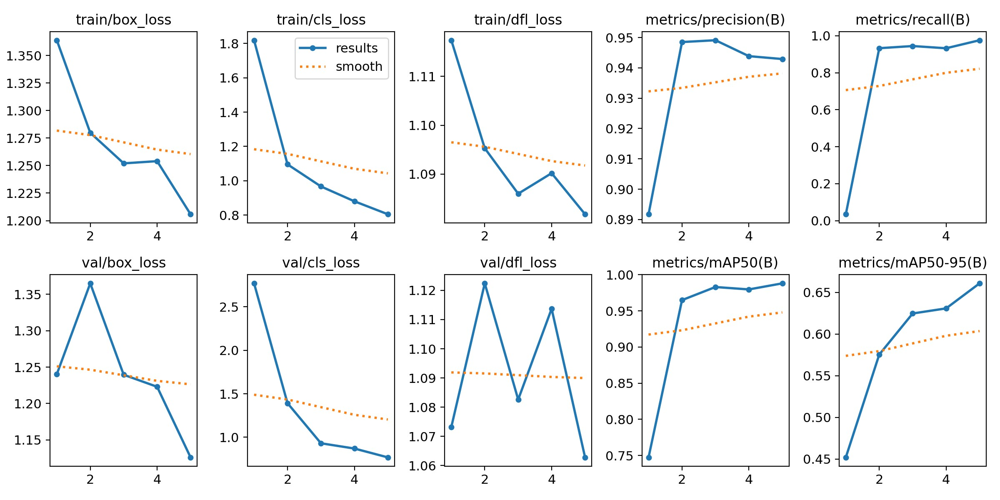

Confusion Matrix:
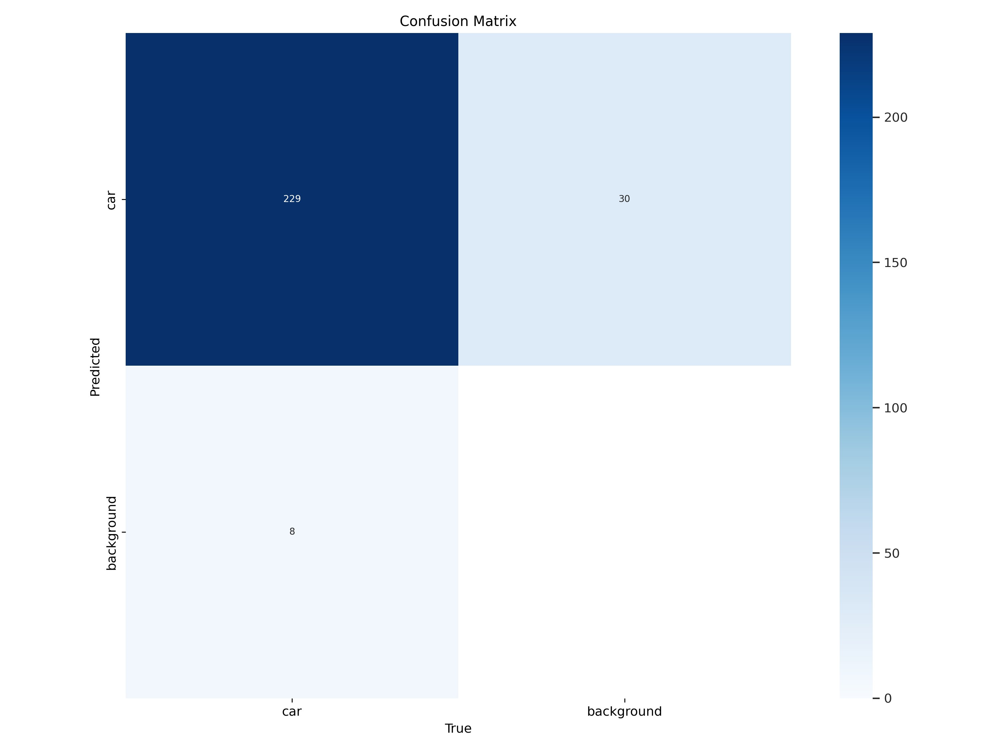

Precision-Recall curve:
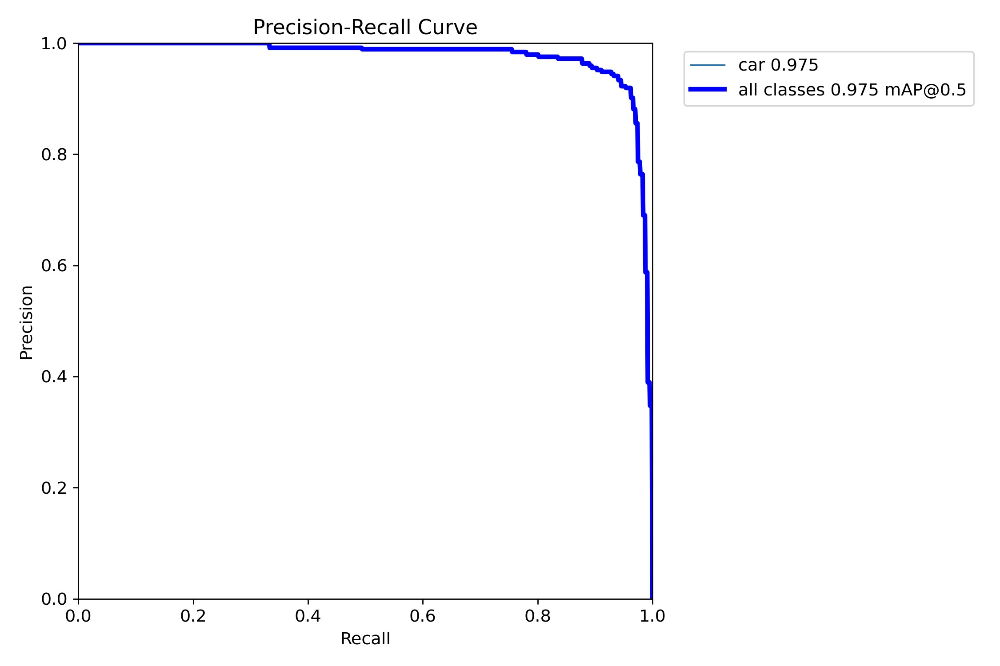

Validation Examples:
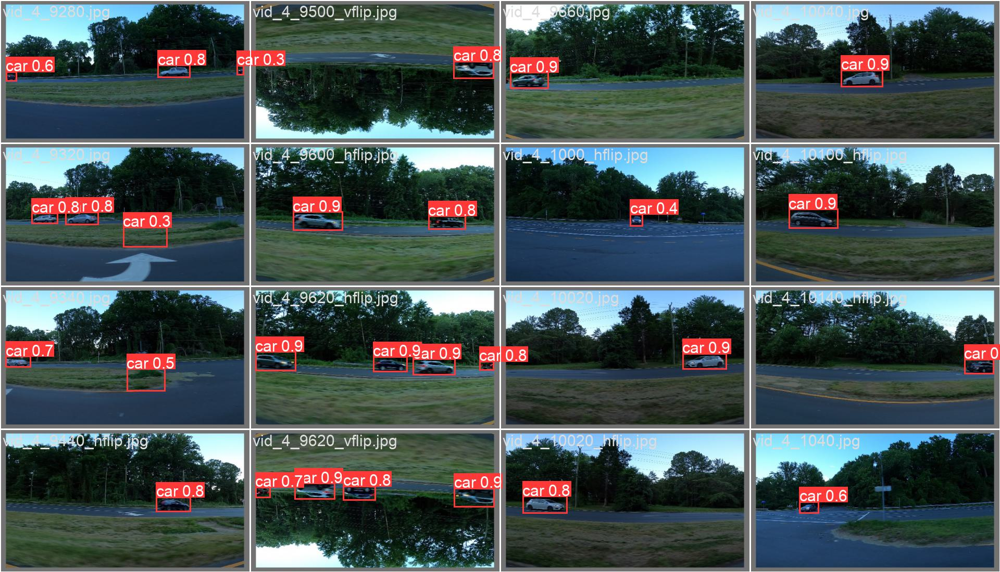

---

#### Question 3 is required for completion for the EEL 5934 section only. Individuals in EEL 4930 are welcome to solve these tasks but no extra credit will be credited.

3. Discuss how you would validate performance in the test set given that no target labels are provided. Discuss also how you would address the case where no car is present in the image. For the latter, it may be useful consider all training images and add a fix target label (e.g. [0,0,0,0]) for all images without a car within it.

    * Consider the case where the exact bounding box location is not particularly the target. There an acceptable margin an error. Perhaps describe your approach in the context of overlapping Region of Interest (ROI).
    
    * You may use [MakeSenseAI](https://www.makesense.ai/) to create your own test labels (a small subset of test samples suffices) to demonstrate your validation metric.

For the Object Detection task, since there are no target labels provided for the test set, one simple way to validate is by visual inspection. But this process is not optimal for large datasets, so by choosing a subset of dataset and manually giving them labels, we can validate the performance based on the ground truth labels.

In the availability of bounding box labels, to validate the performance on the test set, we can use Mean Average Precision (mAP) and Intersection over Union (IoU) metrics, which take into account the overlapping Regions of Interest (ROIs).

**IoU:** Intersection over Union measures the overlap between predicted and actual bounding boxes. It's calculated by dividing the area of overlap by the area of union of these boxes. In scenarios where there's an acceptable margin of error in bounding box location, IoU helps determine how 'close' the predictions are to potential true positives. A threshold (like 0.5) is often set, above which a prediction is considered a true positive.

**mAP:** This metric evaluates the model's precision across different levels of recall, essentially assessing how well the model detects objects (cars, in this case) across varying confidence thresholds. For each confidence level, precision and recall are calculated, and the average precision (AP) is derived. mAP is the mean of these APs across all classes or IoU thresholds. It's crucial when exact bounding box locations aren't the target but rather the model's overall ability to detect cars with a reasonable degree of accuracy.

For images without cars, we can add a fixed target label [0,0,0,0] during training. This teaches the model to recognize 'no car' scenarios. During validation, if the model predicts a bounding box where none should exist, it would negatively impact the mAP, as this would be a false positive.

---